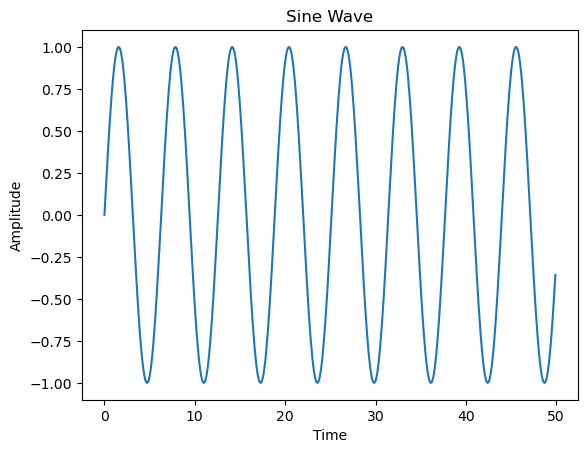

In [1]:
# Necessary imports
import os
# Change directory to the root of the project
os.chdir('..')  # This moves one directory up
import numpy as np
import matplotlib.pyplot as plt
from models.DL.LSTM import LSTMModel

# Generate sine wave data
t = np.linspace(0, 50, 500, endpoint=False)  # 500 points between 0 and 50
data = np.sin(t)

# Plot the data
plt.plot(t, data)
plt.title('Sine Wave')
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.show()

In [2]:
def create_sequences(data, seq_length):
    sequences = []
    targets = []

    for i in range(len(data) - seq_length):
        sequences.append(data[i:i+seq_length])
        targets.append(data[i+seq_length])

    return np.array(sequences), np.array(targets)

seq_length = 10
X, y = create_sequences(data, seq_length)

# Split into training and test sets (80% train, 20% test)
train_size = int(0.8 * len(X))
X_train, y_train = X[:train_size], y[:train_size]
X_test, y_test = X[train_size:], y[train_size:]

In [3]:
input_size = 1  # Since each time step in our sequence has one feature (sine value)
hidden_size = 50
output_size = 1
learning_rate = 0.01

model = LSTMModel(input_size, hidden_size, output_size, learning_rate)

x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
dh_next shape: (50, 1)
dc_next shape: (50, 1)
concat shape: (51, 1)
dz shape: (200, 1)
dh_next shape: (50, 1)
dc_next shape: (50, 1)
concat shape: (51, 1)
dz shape: (200, 1)
dh_next shape: (50, 1)
dc_next shape: (50, 1)
concat shape: (51, 1)
dz shape: (200, 1)
dh_next shape: (50, 1)
dc_next shape: (50, 1)
concat shape: (51, 1)
dz shape: (200, 1)
dh_next shape: (50, 1)
dc_next shape: (50, 1)
concat

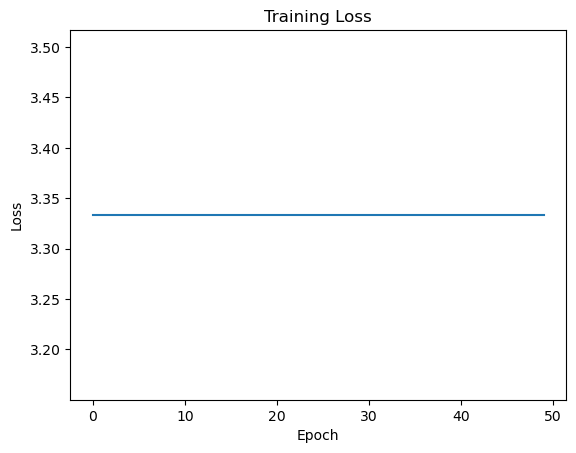

In [4]:
epochs = 50
losses = []

for epoch in range(epochs):
    total_loss = 0
    for i in range(X_train.shape[0]):
        input_seq = X_train[i].reshape(seq_length, 1)
        target = y_train[i]

        y_pred = model.forward(input_seq)
        loss = model.compute_loss(y_pred, target)
        total_loss += loss

        # Backpropagation
        dy = y_pred - target
        model.backward(dy, model.layer.h_values, model.layer.c_values)

    avg_loss = total_loss / len(X_train)
    losses.append(avg_loss)
    print(f"Epoch {epoch+1}/{epochs}, Loss: {avg_loss}")

# Plot the training losses
plt.plot(losses)
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
concat shape: (51, 1)
x shape: (1, 1)
h_prev shape: (50, 1)
co

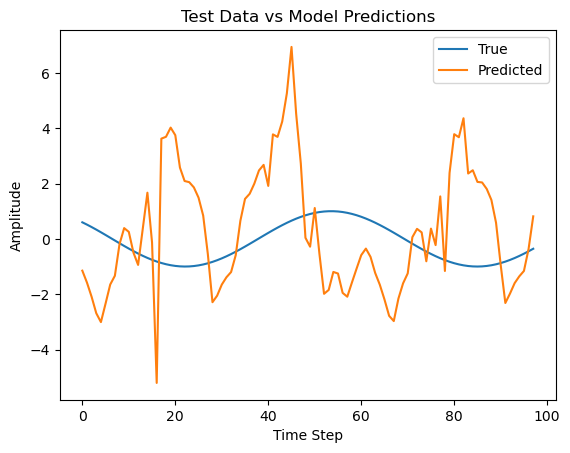

In [5]:
predictions = []

for i in range(X_test.shape[0]):
    input_seq = X_test[i].reshape(seq_length, 1)
    y_pred = model.forward(input_seq)
    predictions.append(y_pred[0][0])

# Plot the actual vs predicted values
plt.plot(y_test, label='True')
plt.plot(predictions, label='Predicted')
plt.title('Test Data vs Model Predictions')
plt.xlabel('Time Step')
plt.ylabel('Amplitude')
plt.legend()
plt.show()